In [1]:
using thesis, PRMaps
using StatsPlots
using Pandas
using Healpix
using StatsPlots
using Plots
using LinearAlgebra

import Stripeline as Sl

In [2]:
wmap = read_pickle("../instruments/wmap_instrument.pkl")
planck = read_pickle("../instruments/planck_instrument.pkl")
quijote = read_pickle("../instruments/quijote_instrument.pkl")
swipe = read_pickle("../instruments/lspe_swipe_instrument.pkl")
strip = read_pickle("../instruments/lspe_strip_instrument.pkl")

columns = ["instrument", "frequency", "depth_p", "depth_i"]

instruments = concat([wmap, planck, quijote, swipe, strip])
instruments = instruments[columns]
instruments

,instrument,frequency,depth_p,depth_i
0,WMAP,22.69,294.697795,293.465609
1,WMAP,32.94,438.561419,296.828735
2,WMAP,40.72,500.985656,415.023172
3,WMAP,40.51,475.110192,393.646897
4,WMAP,60.09,554.721784,520.189018
5,WMAP,60.96,493.519146,462.909657
6,WMAP,92.87,783.584095,750.749159
7,WMAP,93.43,876.013202,839.182282
8,WMAP,92.44,926.757510,887.748258
9,WMAP,93.22,899.656576,861.132559


In [3]:
nside = 64
sky_model = "c1s0d0"

cam_ang = Sl.CameraAngles()
 
setup = PRMaps.Setup(
    sampling_freq_Hz = 50,
    total_time_s = 24. * 3600. * 2.
    )
nothing

# Run simulation without the error

In [4]:
result = run_simulation(instruments, cam_ang, setup, sky_model, nside)

┌ Info: Generating sky signal and noise
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:197
┌ Info: Simulating telescope scanning strategy [LSPE/Strip]
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:201


┌ Info: Adding white noise based on the instruments sensitivity
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:204
┌ Info: Run component separation using fgbuster
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:211


Dict{Any, Any} with 18 entries:
  "nit"       => 10
  "x"         => [1.55024, 19.605, -2.99884]
  "hess_inv"  => [0.000101004 -0.00396782 -6.53897e-6; -0.00396782 0.15795 0.00…
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 50
  "status"    => 2
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; … ; -1.6375e30 …
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 48
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => false
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -8.53917e7
  "Sigma"     => [0.000100659 -0.00395446 -6.4917e-6; -0.00395446 0.157432 0.00…
  "message"   => "Desired error not necessarily achieved due to precision loss."
  "Sigma_inv" => [7.75574e5 19311.1 1.08314e5; 19311.1 488.414 1912.66; 1.08314…
  "jac"       => [-0.00108963, -2.65316e-5, -3.88264e-5]
  "invAtNA"   => [0

In [5]:
par_name = result["params"]
par_val = result["x"]
par_error = sqrt.(diag(result["Sigma"]))

for i in 1:3
    name = par_name[i]
    val = round(par_val[i]; digits = 4)
    err = round(par_error[i]; digits = 4)
    println("$name : $val ⨦ $err")
end

Dust.beta_d : 1.5502 ⨦ 0.01
Dust.temp : 19.605 ⨦ 0.3968
Synchrotron.beta_pl : -2.9988 ⨦ 0.0015


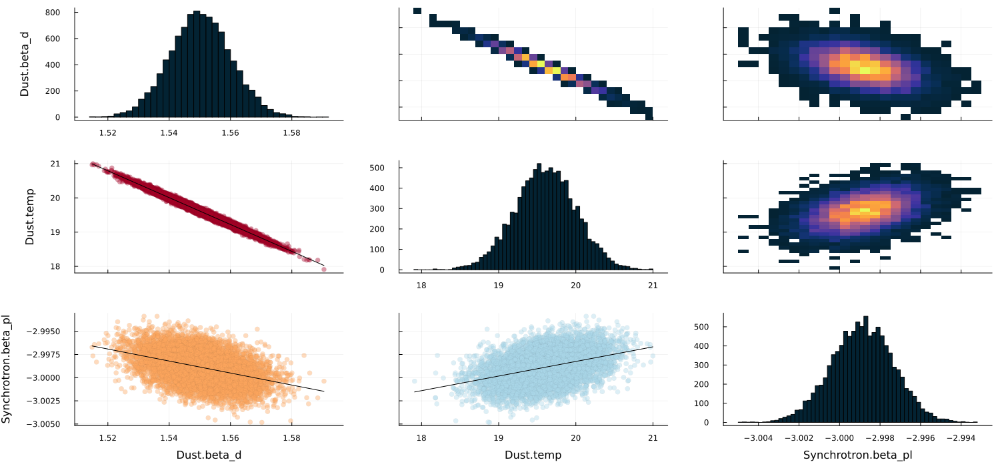

In [6]:
Plots.plot(get_corrplot(result))

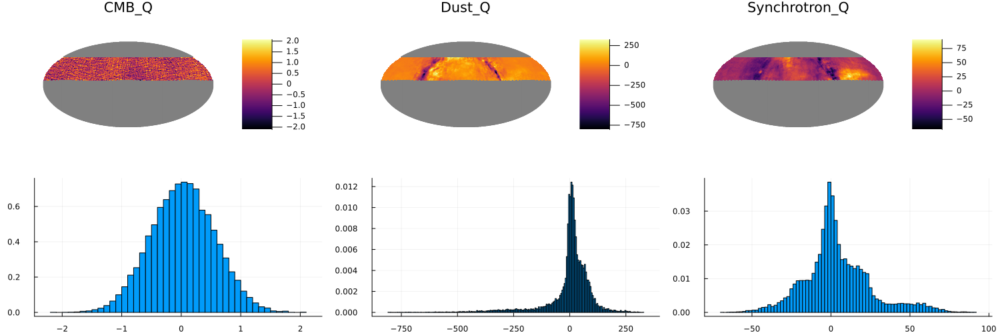

In [7]:
Plots.plot(get_map_and_hist(result, "Q", nside))

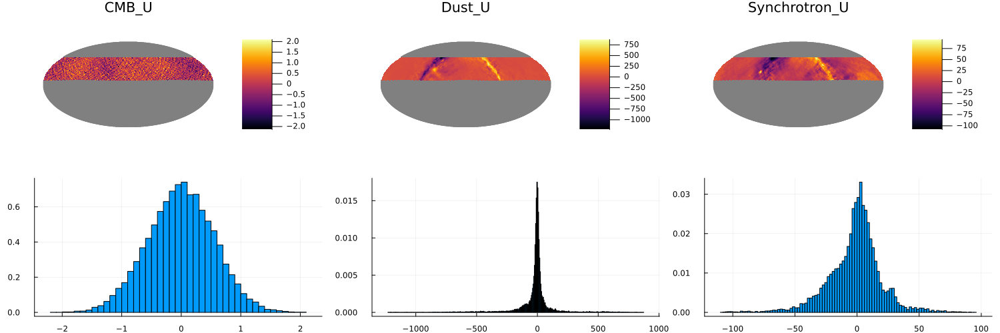

In [8]:
Plots.plot(get_map_and_hist(result, "U", nside))

# Run simulation with pointing error

In [10]:
tel_ang = Sl.TelescopeAngles(
    wheel2ang_0_rad = deg2rad(1.0)
)
nothing

In [11]:
result_with_error = run_simulation_with_error(instruments, cam_ang, tel_ang, setup, sky_model, nside)

┌ Info: Generating sky signal
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:232
┌ Info: Simulating telescope scanning strategy [LSPE/Strip WITH pointing error]
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:236


sys:1: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.


PyCall.PyError: PyError ($(Expr(:escape, :(ccall(#= /home/matteo/.julia/packages/PyCall/ygXW2/src/pyfncall.jl:43 =# @pysym(:PyObject_Call), PyPtr, (PyPtr, PyPtr, PyPtr), o, pyargsptr, kw))))) <class 'TypeError'>
TypeError('first argument must be an iterable of pandas objects, you passed an object of type "DataFrame"')
  File "/home/matteo/opt/miniconda3/envs/tesi/lib/python3.10/site-packages/pandas/util/_decorators.py", line 331, in wrapper
    return func(*args, **kwargs)
  File "/home/matteo/opt/miniconda3/envs/tesi/lib/python3.10/site-packages/pandas/core/reshape/concat.py", line 368, in concat
    op = _Concatenator(
  File "/home/matteo/opt/miniconda3/envs/tesi/lib/python3.10/site-packages/pandas/core/reshape/concat.py", line 403, in __init__
    raise TypeError(


In [12]:
par_name = result["params"]
par_val = result["x"]
par_error = sqrt.(diag(result["Sigma"]))

for i in 1:3
    name = par_name[i]
    val = round(par_val[i]; digits = 4)
    err = round(par_error[i]; digits = 4)
    println("$name : $val ⨦ $err")
end

Dust.beta_d : 1.5502 ⨦ 0.01
Dust.temp : 19.605 ⨦ 0.3968
Synchrotron.beta_pl : -2.9988 ⨦ 0.0015


In [13]:
plot(get_corrplot(result_with_error))

UndefVarError: UndefVarError: result_with_error not defined

In [14]:
plot(get_map_and_hist(result_with_error, "Q", nside))

UndefVarError: UndefVarError: result_with_error not defined

In [15]:
plot(get_map_and_hist(result_with_error, "U", nside))

UndefVarError: UndefVarError: result_with_error not defined